<a href="https://colab.research.google.com/github/eebeohar/stock_predict/blob/main/assign_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Section 1: Import Libraries

In [ ]:
"""
Stock Price Prediction using LSTM and Linear Regression
Author: [Eeshan Beohar]
"""

# System operations
import glob
import pickle
import os
from os import listdir
from os.path import isfile, join

# Data processing
import numpy as np
import pandas as pd
import random
from datetime import datetime
import datetime
# Machine Learning
from sklearn.preprocessing import MinMaxScaler as MMS
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Deep Learning
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.optimizers import Adam

# Visualization
import matplotlib.pyplot as plt



# Section 2: Functions (Data Assemply & Preprocessing)

In [ ]:
def default_ohlc():
    return {
        'Open_Price': None,
        'High_Price': float('-inf'),
        'Low_Price': float('inf'),
        'Close_Price': None,
        'Total_vol': 0,
        'Total_bs':0,
        'Total_ss':0,
        'Total_order':0,
        'Total_bs_orders':0,
        'Total_ss_orders':0,
        'Total_bs_mkt_ioc':0,
        'Total_ss_mkt_ioc':0
    }

def data_assembly(df,Token,in_date_time,timesteps) :

  if (df == Token).any().any():
    print("Token exists in the DataFrame")
  df=df[(df['Token']==Token)]
  df['df_close_price'] = df['Close_Price'].pct_change().dropna()
  df['y_close_price'] = df['df_close_price'].shift(-timesteps).dropna()


  df_y_train = df[(df['Date_Time']<=in_date_time)]['y_close_price'].dropna()
  df_x_train = df[(df['Date_Time']<=in_date_time)]['df_close_price'].dropna()
  common_index = df_x_train.index.intersection(df_y_train.index)
  df_x_train, df_y_train = df_x_train.loc[common_index].values, df_y_train.loc[common_index].values

  print(df_y_train.shape)
  print(df_x_train.shape)

  y_train_data_raw = df_y_train.reshape(df_y_train.shape[0],1)
  x_train_data_raw = df_x_train.reshape(df_x_train.shape[0],1)
  obj1 = MMS(feature_range=(0,1))
  y_train_data_norm = obj1.fit_transform(y_train_data_raw)
  x_train_data_norm = obj1.fit_transform(x_train_data_raw)
  y_train_len = np.ceil(len(y_train_data_norm)*0.8)
  x_train_len = np.ceil(len(x_train_data_norm)*0.8)
  print(y_train_len)
  print(x_train_len)
  y_train_data = y_train_data_norm[0:int(y_train_len),:]
  x_train_data = x_train_data_norm[0:int(x_train_len),:]

  y_test_len = np.ceil(len(y_train_data_norm)*0.1)
  x_test_len = np.ceil(len(x_train_data_norm)*0.1)
  y_val_data = y_train_data_norm[int(y_train_len):int(y_train_len) + int(y_test_len),:]
  y_test_data = y_train_data_norm[int(y_train_len) + int(y_test_len):,:]
  x_val_data = x_train_data_norm[int(x_train_len):int(x_train_len) + int(x_test_len),:]
  x_test_data = x_train_data_norm[int(x_train_len) + int(x_test_len):,:]



  return x_train_data,y_train_data,x_val_data,y_val_data,x_test_data,y_test_data,obj1,x_train_data_raw,y_train_data_raw#,final_price


def create_df(file_list,csv_file):
  date_list=[]
  for f in file_list:
    date= f.split('/')[-2]
    dd = str(date[3]+ date[4])
    date_list.append('2025-02-'+str(dd))

  print('Available Dates',date_list)
  #give your path to read
  token_mapping=pd.read_csv(csv_file,parse_dates=True)

  # token_mapping.head()

  with open(glob.glob(file_list[0]+'*.pkl',recursive=True)[0], 'rb') as file:
      ohlc_data_dum = pickle.load(file)
      print(ohlc_data_dum)
      # Convert dictionary to DataFrame

        # Convert dictionary to DataFrame
      df_dum = pd.DataFrame.from_dict(ohlc_data_dum, orient='index')
      df_dum.reset_index(inplace=True)
      df_dum.head()
  df_dum.columns = ['Token', 'hour_min', 'Open_Price', 'High_Price', 'Low_Price', 'Close_Price', 'Total_vol','Total_bs','Total_ss','Total_order','Total_bs_orders','Total_ss_orders','Total_bs_mkt_ioc','Total_ss_mkt_ioc']
  df_dum['Date_Time']=pd.to_datetime(str(date_list[0])+' '+df_dum['hour_min'])
  df_dum['Date_Time']=pd.to_datetime(df_dum['Date_Time'])


  df_dum['Token']=df_dum['Token'].astype(int)
  df_dum=df_dum.merge(token_mapping,how='inner',on='Token')
  print('Available Token',df_dum['Token'].values)


  for i in range(len(file_list)):
    pkl_list = glob.glob(file_list[i]+'*.pkl',recursive=True)
    for j in range(len(pkl_list)):
      with open(pkl_list[j], 'rb') as file:
        ohlc_data = pickle.load(file)
        df = pd.DataFrame.from_dict(ohlc_data, orient='index')
        df.reset_index(inplace=True)
        df.columns = ['Token', 'hour_min', 'Open_Price', 'High_Price', 'Low_Price', 'Close_Price', 'Total_vol','Total_bs','Total_ss','Total_order','Total_bs_orders','Total_ss_orders','Total_bs_mkt_ioc','Total_ss_mkt_ioc']
        df['Date_Time']=pd.to_datetime(str(date_list[i])+' ' +df['hour_min'])
        df['Date_Time']=pd.to_datetime(df['Date_Time'])
        # df['Date_Time']=df['Date_Time'].apply(lambda x: x.timestamp()*10**-9)
        df['Token']=df['Token'].astype(int)
        df=df.merge(token_mapping,how='inner',on='Token')
        df_dum=pd.concat([df_dum,df],ignore_index=True)
  df_dum = df_dum.sort_values('Date_Time', ascending=True)
  return df_dum

# Section 3: Main Execution
We go by a model per stock approach in this work. The User Inputs are as follows:
*   Unique Token ID (here we are selecting random token but alternatively, one can explicitly specify it )
*   Date-time in datetime format: 'yyyy-mm-dd hh:mm'
*   timesteps (time window) to be considered for our model: this is essentially a hyperparameter which may need to be optimised for each stock. However, here we choose it to be 15.
*   delta_t: this is the time after which we want to forecast the closing price: can be either 5 (in mins) or 3 (in mins).


In [ ]:

# Initialize file paths
file_list = glob.glob("/content/drive/MyDrive/IIT assignment Indira securities/*/", recursive=True)
csv_file = '/content/drive/MyDrive/IIT assignment Indira securities/token_mapping.csv'

# Create consolidated dataframe
df = create_df(file_list, csv_file)

Available Dates ['2025-02-24', '2025-02-20', '2025-02-25', '2025-02-21', '2025-02-27']
defaultdict(<function default_ohlc at 0x7f7ddf97c180>, {('12848', '04:00'): {'Open_Price': 300.0, 'High_Price': 300.0, 'Low_Price': 300.0, 'Close_Price': 300.0, 'Total_vol': 19.0, 'Total_bs': 8.0, 'Total_ss': 11.0, 'Total_order': 5, 'Total_bs_orders': 2, 'Total_ss_orders': 3, 'Total_bs_mkt_ioc': 0, 'Total_ss_mkt_ioc': 0}, ('12848', '04:15'): {'Open_Price': 300.0, 'High_Price': 300.0, 'Low_Price': 300.0, 'Close_Price': 300.0, 'Total_vol': 19.0, 'Total_bs': 8.0, 'Total_ss': 11.0, 'Total_order': 5, 'Total_bs_orders': 2, 'Total_ss_orders': 3, 'Total_bs_mkt_ioc': 0, 'Total_ss_mkt_ioc': 0}, ('12848', '04:30'): {'Open_Price': 300.0, 'High_Price': 300.0, 'Low_Price': 300.0, 'Close_Price': 300.0, 'Total_vol': 19.0, 'Total_bs': 8.0, 'Total_ss': 11.0, 'Total_order': 5, 'Total_bs_orders': 2, 'Total_ss_orders': 3, 'Total_bs_mkt_ioc': 0, 'Total_ss_mkt_ioc': 0}, ('12848', '04:45'): {'Open_Price': 300.0, 'High_Price

In [ ]:
# Select random token and set parameters
# token = random.choice(df['Token'].values)
# Alternatively use fixed token:
token = 29171
in_date_time, timesteps = '2025-02-27 10:45', 3
# Prepare training data
x_train, y_train, x_val, y_val, x_test, y_test, scaler, x_raw, y_raw = data_assembly(
    df, token, in_date_time,timesteps)

Token exists in the DataFrame
(1695,)
(1695,)
1356.0
1356.0


<ipython-input-2-4e4a2482154b>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['df_close_price'] = df['Close_Price'].pct_change().dropna()
<ipython-input-2-4e4a2482154b>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['y_close_price'] = df['df_close_price'].shift(-timesteps).dropna()


# Section 4: LSTM Model

In [ ]:

# Build LSTM architecture
model = Sequential()
model.add(LSTM(64,return_sequences=True,input_shape=(x_train.shape[1],1)))
model.add(LSTM(128))
model.add(Dense(128))
model.add(Dense(1))
model.summary()


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 1, 64)               │          16,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 132,353 (517.00 KB)

 Trainable params: 132,353 (517.00 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile and train
model.compile(optimizer=Adam(learning_rate=0.0001), loss='mean_squared_error')
history = model.fit(
    x_train, y_train,
    validation_data=(x_val, y_val),
    epochs=15,
    batch_size=1,
)


Epoch 1/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - loss: 0.0433 - val_loss: 0.0012
Epoch 2/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 0.0029 - val_loss: 0.0012
Epoch 3/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 0.0021 - val_loss: 0.0013
Epoch 4/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 0.0022 - val_loss: 0.0012
Epoch 5/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - loss: 0.0027 - val_loss: 0.0012
Epoch 6/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0021 - val_loss: 0.0012
Epoch 7/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0023 - val_loss: 0.0013
Epoch 8/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 0.0020 - val_loss: 0.0012
Epoch 9/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - loss: 0.0025 - val_loss: 0.0012
Epoch 10/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0022 - val_loss: 0.0012
Epoch 11/15
1356/1356 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - loss: 0.0025 - val_loss: 0.0012
Epoch 12/15
1356/1356 ━━

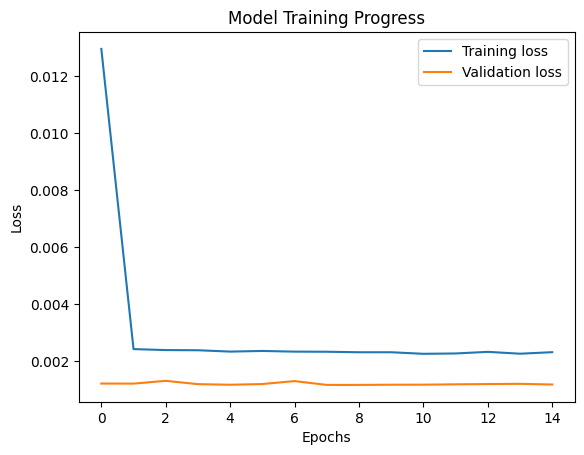

In [ ]:
# Plot training history
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.title('Model Training Progress')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()




In [ ]:
# Make predictions and inverse scaling
predicted_y = model.predict(x_test)
predicted_y = scaler.inverse_transform(predicted_y)
actual_y = scaler.inverse_transform(y_test.reshape(-1,1))

# Evaluate LSTM performance
print('\nLSTM Performance:')
print(f'R2 Score: {r2_score(actual_y, predicted_y):.4f}')
print(f'MAE: {mean_absolute_error(actual_y, predicted_y):.4f}')

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step

LSTM Performance:
R2 Score: 0.0012
MAE: 0.0011


# Section 5: Linear Regression

In [ ]:

# Prepare data for linear regression
train_size = int(len(y_raw) * 0.9)
X_train_lr, X_test_lr = x_raw[:train_size], x_raw[train_size:]
y_train_lr, y_test_lr = y_raw[:train_size], y_raw[train_size:]

# Train and evaluate
lr_model = LinearRegression()
lr_model.fit(X_train_lr, y_train_lr)
y_pred_lr = lr_model.predict(X_test_lr)

print('\nLinear Regression Performance:')
print(f'R2 Score: {r2_score(y_test_lr, y_pred_lr):.4f}')
print(f'MAE: {mean_absolute_error(y_test_lr, y_pred_lr):.4f}')




Linear Regression Performance:
R2 Score: -0.0070
MAE: 0.0011


# Section 6: Visualization

In [ ]:
rolling_mean = pd.Series(actual_y.flatten()).rolling(window=10).mean()
rolling_std = pd.Series(actual_y.flatten()).rolling(window=10).std()

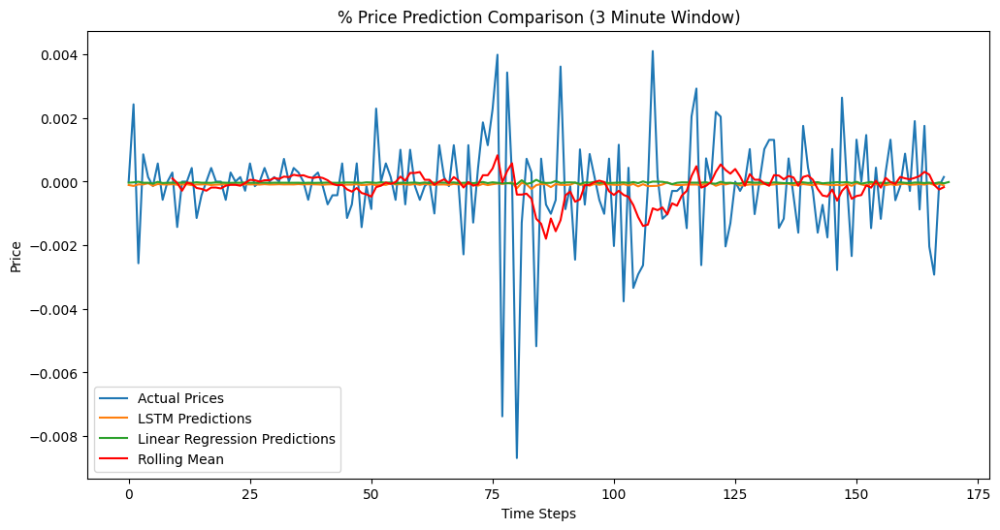

In [ ]:
# ----------------------------
# ----------------------------

plt.figure(figsize=(12,6))
plt.plot(actual_y, label='Actual Prices')
plt.plot(predicted_y, label='LSTM Predictions')
plt.plot(y_pred_lr, label='Linear Regression Predictions')
plt.plot(rolling_mean, label='Rolling Mean', color='red')
plt.title('% Price Prediction Comparison (3 Minute Window)')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.legend()
plt.show()

<ipython-input-12-95b4ec2bcca8>:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


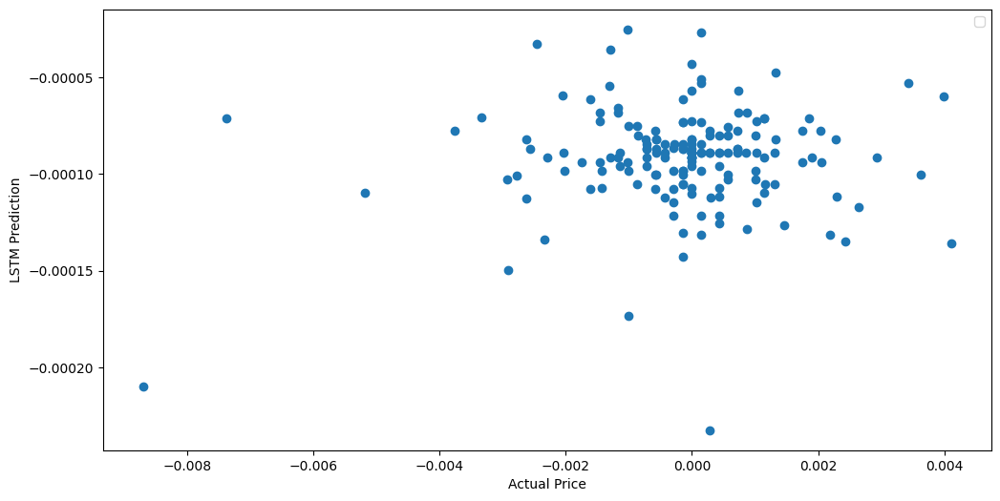

In [ ]:
# ----------------------------
# ----------------------------

plt.figure(figsize=(12,6))
plt.scatter(actual_y,predicted_y)
# plt.plot(predicted_y, label='LSTM Predictions')
# plt.plot(y_pred_lr, label='Linear Regression Predictions')
# plt.title('Price Prediction Comparison')
plt.xlabel('Actual Price')
plt.ylabel('LSTM Prediction')
plt.legend()
plt.show()

In [ ]:
print('% Change in Close Price After 3 Minutes:\n'+'LSTM:'+str(predicted_y[-1])+'\nLinear Regression:'+str(y_pred_lr[-1])+'\nActual:'+str(actual_y[-1]))

% Change in Close Price After 15 Minutes:
LSTM:[-0.00012178]
Linear Regression:[-1.33984699e-05]
Actual:[0.00014665]
